In [ ]:
#Dependencies You will need
!pip install pointillism
!pip install numpy
!pip install opencv-python
!pip install ipython
!pip install Pillow

In [2]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import pointillism as pt
from IPython.display import HTML
from IPython import display

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount = True)

  First Image is the original photo followed by an OilPainting and a WaterColor Version   




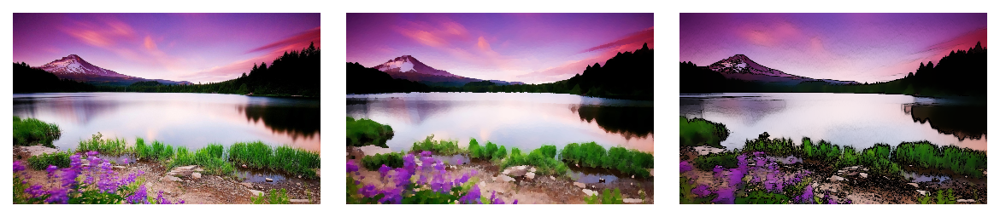

In [4]:
img = cv2.imread('/content/drive/MyDrive/Photos/Scenery.jpg')
half_OG = cv2.resize(img, (0, 0), fx = 0.25, fy = 0.25)
OP = cv2.xphoto.oilPainting(img, 7, 1)
half_OP = cv2.resize(OP, (0, 0), fx = 0.25, fy = 0.25)
Watr_Colr = cv2.stylization(img, sigma_s=150, sigma_r=0.43)
half_WC = cv2.resize(Watr_Colr, (0, 0), fx = 0.25, fy = 0.25)


white = [255,255,255]
Original = cv2.copyMakeBorder(half_OG,15,15,15,15,cv2.BORDER_CONSTANT,value=white)
Oil_Painting= cv2.copyMakeBorder(half_OP,15,15,15,15,cv2.BORDER_CONSTANT,value=white)
Water_Color = cv2.copyMakeBorder(half_WC,15,15,15,15,cv2.BORDER_CONSTANT,value=white)
Final_Frame = cv2.hconcat((Original, Oil_Painting,Water_Color))
txt = "First Image is the original photo followed by an OilPainting and a WaterColor Version"
x = txt.center(90)
print(x)
print("\n")
cv2_imshow(Final_Frame)

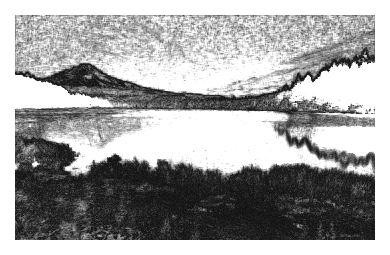

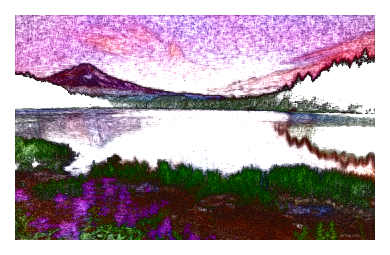

In [5]:
dst_gray,dst_color= cv2.pencilSketch(img, sigma_s=50, sigma_r=0.06, shade_factor=0.035) 
half_GS = cv2.resize(dst_gray, (0, 0), fx = 0.25, fy = 0.25)
half_CS = cv2.resize(dst_color, (0, 0), fx = 0.25, fy = 0.25)

Grey_Sketch = cv2.copyMakeBorder(half_GS,15,15,15,15,cv2.BORDER_CONSTANT,value=white)
Color_Sketch= cv2.copyMakeBorder(half_CS,15,15,15,15,cv2.BORDER_CONSTANT,value=white)
txt = "These Sketches are using OpenCV's Inbuilt Sketch Libraries, which we will improve later on "
x = txt.center(90)
cv2_imshow(Grey_Sketch)
cv2_imshow(Color_Sketch)

In [6]:
background_colour = [247,19,217]
dots_colour = (0,0,0)

# set the max dots (on the longest side of the image)
max_dots = 120

# import the image as greyscale
original_image = cv2.imread('/content/drive/MyDrive/Photos/MM.jpg', 0)

# extract dimensions
original_image_height, original_image_width = original_image.shape

# down size to number of dots
if original_image_height == max(original_image_height,original_image_width):
  downsized_image = cv2.resize(original_image,(int(original_image_height*(max_dots/original_image_width)),max_dots))
else:
  downsized_image = cv2.resize(original_image,(max_dots,int(original_image_height*(max_dots/original_image_width))))

# extract dimensions of new image
downsized_image_height, downsized_image_width = downsized_image.shape

# set how big we want our final image to be
multiplier = 100

# set the size of our blank canvas
blank_img_height = downsized_image_height * multiplier
blank_img_width = downsized_image_width * multiplier

# set the padding value so the dots start in frame (rather than being off the edge
padding = int(multiplier/2)

# create canvas containing just the background colour
final_image = np.full(((blank_img_height),(blank_img_width),3), background_colour,dtype=np.uint8)

# run through each pixel and draw the circle on our blank canvas
for y in range(0,downsized_image_height):
  for x in range(0,downsized_image_width):
    cv2.circle(final_image,(((x*multiplier)+padding),((y*multiplier)+padding)), int((0.6 * multiplier) * ((255-downsized_image[y][x])/255)), dots_colour, -1)

# save our image
cv2.imwrite('/content/drive/MyDrive/Photos/Dot_Art_Image.png',final_image)

True

In [7]:
from IPython.display import Image
Image('/content/drive/MyDrive/Photos/Dot_Art_Image.png')

In [ ]:
# Color Combinations you can try yourself changing 
#the background and dot colors 
#(Pick either highly contrasting bright colors or 1Dark and 1 Bright)
(247,19,217) - Purple
[19,247,224] - Yellow
(0,0,0) - Black 
(255,255,255) - White 
(25,51,43) - Viridian
(61,21,95) - Deeper Purple
(223,103,240) - Pink
(18,24,49) - Deep Blue
(98,92,92) - Baby Pink
(3,57,82)- Electric Blue
(255,105,180) - Hot Pink
(1,116,120) - Maxi Teal


                                  Smoother Pencil Sketch                                  




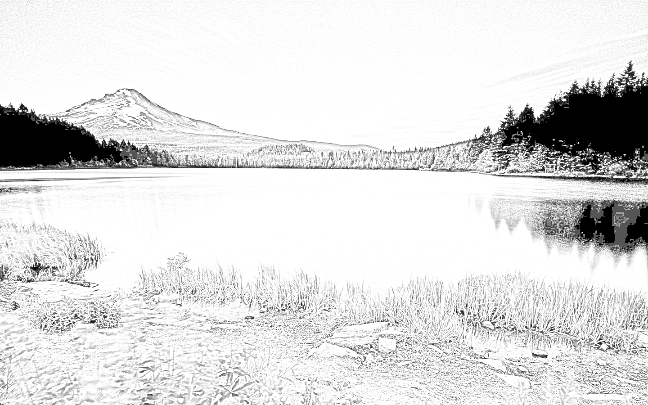

In [9]:
'''Smooth Pencil Sketch '''
img1 = cv2.imread('/content/drive/MyDrive/Photos/Scenery.jpg')
img_gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img_gray_inv = 255 - img_gray
img_blur = cv2.GaussianBlur(img_gray_inv, ksize=(21, 21),sigmaX=0, sigmaY=0)

def Lightening(image, mask):
  return cv2.divide(image, 255-mask, scale=256)

def Darkening(image, mask):
  return 255 - cv2.divide(255-image, 255-mask, scale=256)

img_blend = Lightening(img_gray, img_blur)
half_Sketch = cv2.resize(img_blend, (0, 0), fx = 0.45, fy = 0.45)
txt = "Smoother Pencil Sketch"
x = txt.center(90)
print(x)
print("\n")
cv2_imshow(half_Sketch)

                                   A Cartoonized Image                                    




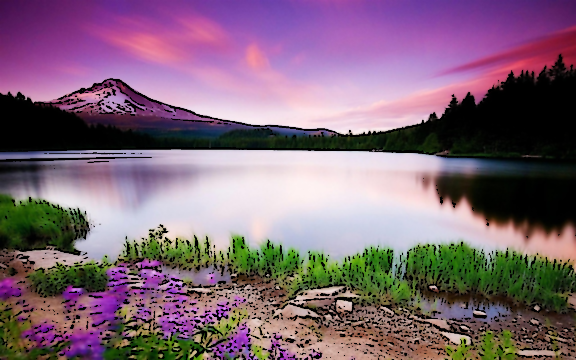

In [10]:
# Cartoonizing an Image
img2 = cv2.imread('/content/drive/MyDrive/Photos/Scenery.jpg')
gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY) 
gray = cv2.medianBlur(gray, 5) 
edges = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,13,13) 
   
# Cartoonization 
color = cv2.bilateralFilter(img2, 7, 250, 250) 
cartoon = cv2.bitwise_and(color, color, mask=edges) 
half_Cartoon = cv2.resize(cartoon, (0, 0), fx = 0.4, fy = 0.4)

txt = "A Cartoonized Image"
x = txt.center(90)
print(x)
print("\n")
cv2_imshow(half_Cartoon) 

In [11]:
point = pt.image(location='/content/drive/MyDrive/Photos/pedro-lastra-Nyvq2juw4_o-unsplash.jpg', debug = True)
point.crop([500,500], False)
point.make('ultrafine')
txt = "Pointillist Image"
x = txt.center(90)
txt1 = "Original Image"
x1 = txt1.center(90)
point.save_out(location='/content/drive/MyDrive/Photos/', suffix='Pointillist_Image')


done in 15.95 seconds


                                      Original Image                                      


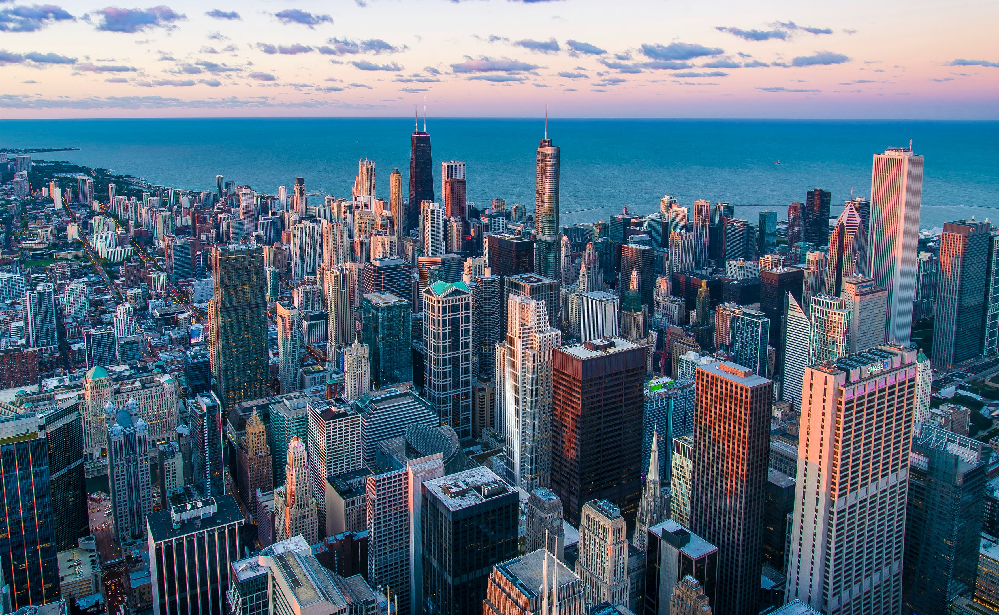

In [12]:
print(x1)
Image('/content/drive/MyDrive/Photos/pedro-lastra-Nyvq2juw4_o-unsplash.jpg')

                                    Pointillist Image                                     
/content/drive/MyDrive/Photos/pedro-lastra-Nyvq2juw4_o-unsplash.jpg


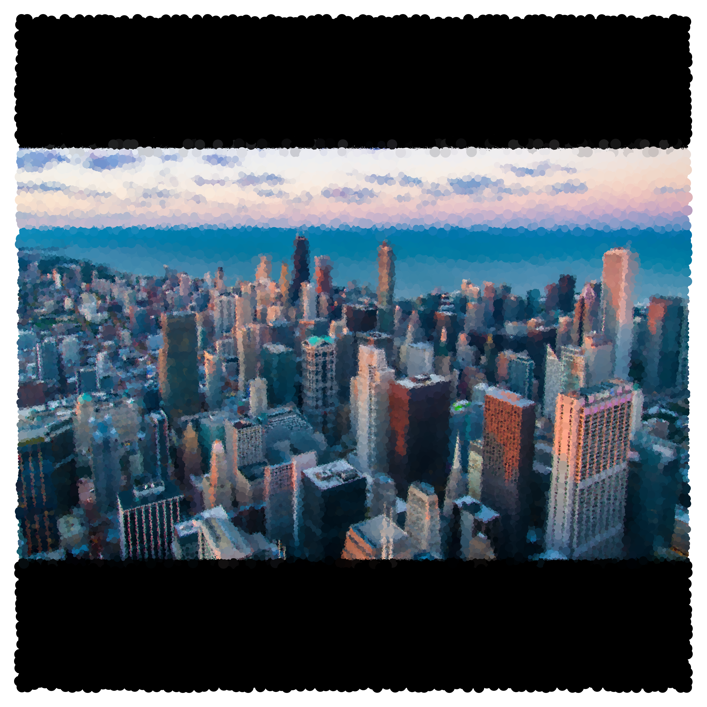

In [13]:
print(x)
point.display()

In [14]:
point2 = pt.pipeline(location='/content/drive/MyDrive/Photos/pedro-lastra-Nyvq2juw4_o-unsplash.jpg', debug = True, border = 0)

# Render
point2.make_gif(kind='multiplier', location='/content/drive/MyDrive/Photos/', name='animated_multiplier.gif', crop=False)

Building image:  1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 done


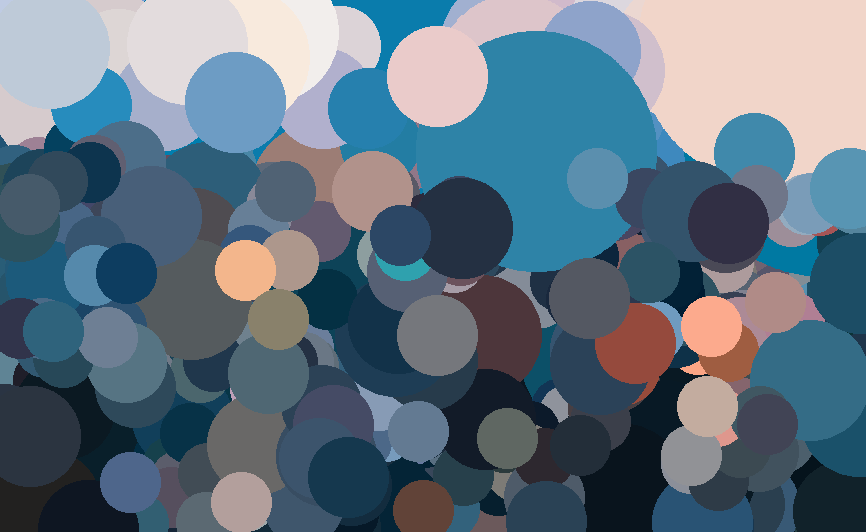

In [16]:
import os
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from IPython import display
gif_path = '/content/drive/MyDrive/Photos/animated_multiplier.gif'
with open(gif_path,'rb') as f:
    display.Image(data=f.read(), format='png')
